In [1]:
import numpy as np
import scipy.integrate as integ
import matplotlib.pyplot as plt

from matplotlib.animation import FuncAnimation
from IPython.display import HTML

plt.rc('figure', figsize=(9, 7))
plt.rcParams.update({'text.usetex': True,
                     'font.family': 'serif',
                     'font.serif': ['Georgia'],
                     'mathtext.fontset': 'cm',
                     'lines.linewidth': 2.5,
                     'font.size': 20,
                     'xtick.labelsize': 'large',
                     'ytick.labelsize': 'large',
                     'xtick.direction': 'in',
                     'ytick.direction': 'in',
                     'xtick.major.width': 1.7,
                     'ytick.major.width': 1.7,
                     'xtick.major.size': 7.,
                     'ytick.major.size': 7.,
                     'ytick.right':True, 
                     'axes.labelsize': 'large',
                     'axes.titlesize': 'large',
                     'axes.grid': True,
                     'grid.alpha': 0.5,
                     'lines.markersize': 12,
                     'legend.borderpad': 0.2,
                     'legend.fancybox': True,
                     'legend.fontsize': 17,
                     'legend.framealpha': 0.7,
                     'legend.handletextpad': 0.5,
                     'legend.labelspacing': 0.2,
                     'legend.loc': 'best',
                     'savefig.bbox': 'tight',
                     'savefig.pad_inches': 0.05,
                     'savefig.dpi': 80,
                     'pdf.compression': 9})

# Part I: Keplerian Orbit

In [2]:
def orb_motion(t, y, mu, k):
    """
    y = [r, drdt, phi, dphidt]
    where the displacement between the binary is (x, y, z) with
        x = r * cos(phi)
        y = r * sin(phi)
        z = 0 
        
    compute dydt
    """
    r, drdt, phi, dphidt = y
    
    dydt = np.zeros(len(y))
    
    # the first two eqs. describe the radial motion
    dydt[0] = drdt
    dydt[1] = r * dphidt**2 - k / (mu * r**2)    
    
    # the last two eqs. are for the tangential motion
    dydt[2] = dphidt
    dydt[3] = - 2. * drdt * dphidt / r  # this eq is a direct consequence of l = mu * r * dphidt^2 is a constant
    
    return dydt

In [3]:
# parameters of the system
# here we use some abstract numbers for numerical simplicity

kk = 1 # G*M1*M2
mu = 1 # M1*M2/(M1+M2)
ll = 1 # orbital angular momentum
EE = -0.3 # orbital energy

## Effective potential

Text(0, 0.5, '$U_{\\rm eff}$')

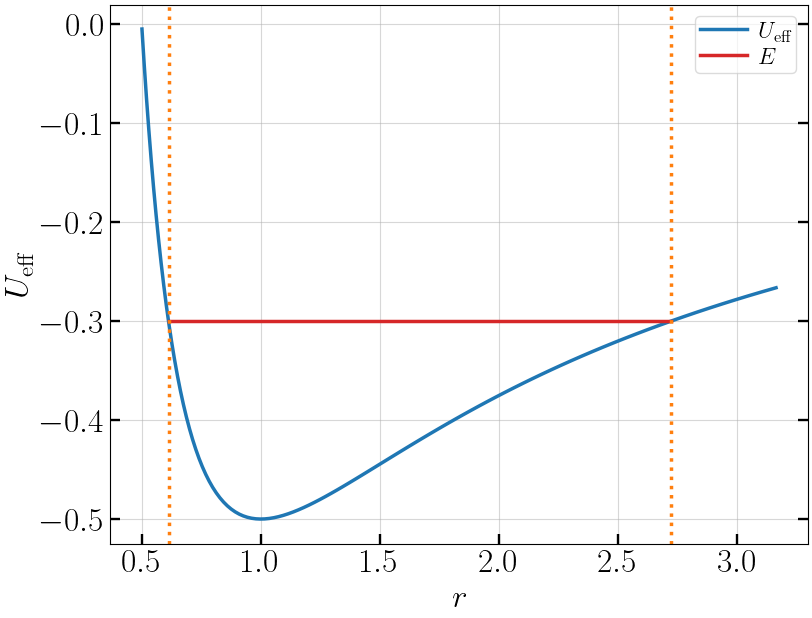

In [4]:
# effective potential 
rr = np.logspace(-0.3, 0.5, 100)
U_eff = -kk / rr + ll**2/(2*mu*rr**2.) 
# Q: what is the asymptotic behavior of U_eff? What is U_eff when r->infty? And when r->0?


# note that the system is bounded in regions where E>=U_eff
# expected location of the pericenter (r=r_min) and apocenter(r=r_max)
r_min = -kk/(2*EE) - np.sqrt((kk/(2*EE))**2 + ll**2/(2.*mu*EE))
r_max = -kk/(2*EE) + np.sqrt((kk/(2*EE))**2 + ll**2/(2.*mu*EE))


# plot the result
fig=plt.figure()
ax=fig.add_subplot(111)
ax.plot(rr, U_eff, label=r'$U_{\rm eff}$')
ax.plot([r_min, r_max], [EE, EE], color='tab:red', label=r'$E$')
# ax.axhline(EE, ls='--', color='tab:red', label=r'$E$')
ax.axvline(r_min, ls=':', color='tab:orange')
ax.axvline(r_max, ls=':', color='tab:orange')

ax.legend()

ax.set_xlabel(r'$r$')
ax.set_ylabel(r'$U_{\rm eff}$')

## Solve the equations

Text(0, 0.5, '$\\phi/2\\pi$')

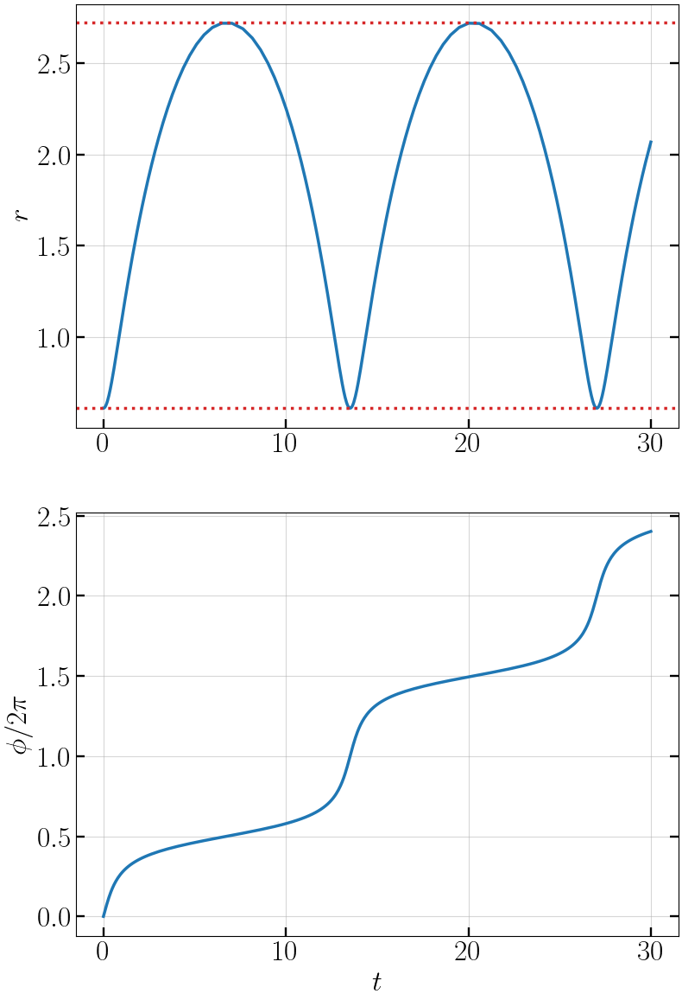

In [5]:
# let us numerically solve the orbital equations!

# start the integration at the pericenter
# note when r is at an extremum, dr = 0!
y_init = np.array([r_min, 0, 0, ll/(mu*r_min**2)])

# solve an ordinary differential equation using solve_ivp

# first integrate it for some arbitary amount of time
t_span = (0, 30)
sol = integ.solve_ivp(orb_motion, t_span, y_init, args=(mu, kk), 
                      atol=1e-8, rtol=1e-8)

tt = sol.t
rr = sol.y[0]
phi = sol.y[2]

fig=plt.figure(figsize=(9, 14))

# plot the binary separation
ax=fig.add_subplot(211)
ax.plot(tt, rr)

# check that the separation is indeed bounded between r_min and r_max!
ax.axhline(r_min, ls=':', color='tab:red')
ax.axhline(r_max, ls=':', color='tab:red')

ax.set_ylabel(r'$r$')

# plot the orbital phase
ax=fig.add_subplot(212)
ax.plot(tt, phi/2/np.pi)
ax.set_xlabel(r'$t$')
ax.set_ylabel(r'$\phi/2\pi$')

## trajectory of the separation vector

Text(0, 0.5, '$y$')

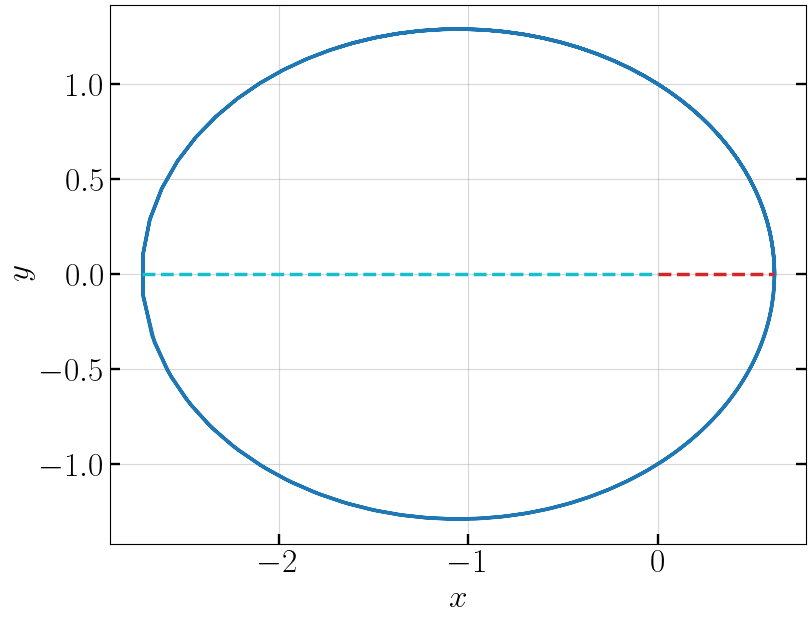

In [6]:
xx = rr*np.cos(phi)
yy = rr*np.sin(phi)

fig=plt.figure()
ax=fig.add_subplot(111)
ax.plot(xx, yy)

ax.plot([0, r_min], [0, 0], color='tab:red', ls='--')
ax.plot([-r_max, 0], [0, 0], color='tab:cyan', ls='--')

ax.set_aspect('equal')
ax.set_xlabel(r'$x$')
ax.set_ylabel(r'$y$')

# Conclusion: 
# the binary's orbit traces out an ellipse (Kepler's first law)
# semi-major axis a: a = (r_min + r_max)/2
# eccentricity e: r_min = a*(1-e), r_max = a*(1+e)

# in terms of a & e:
# orbital energy E = - G * Mt * mu / (2 * a)
# orbital angular momentum l = mu * sqrt(G * Mt * a * (1-e^2)) 
# l being a constant => Kepler's second law


In [ ]:
# Q: what is the maximum energy for the orbit to remain bound?
# Q: what is the minimum energy for the orbit give U_eff? What is special about this orbit?

## Orbital period

Text(0, 0.5, '$\\phi/2\\pi$')

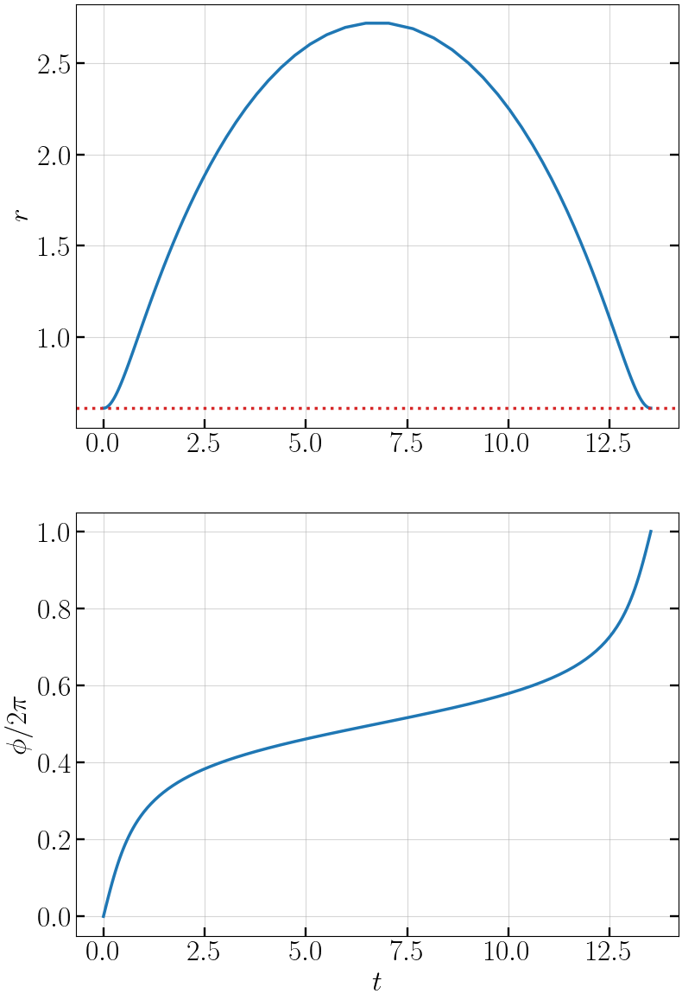

In [7]:
# now let us find the orbit period

# define an event function
# the ODE solver terminates when its result goes from negative to positive
# see: https://docs.scipy.org/doc/scipy/reference/generated/scipy.integrate.solve_ivp.html#scipy.integrate.solve_ivp
def hit_phi_2pi(t, y, mu, k):
    phi = y[2]
    diff = phi - 2.*np.pi
    return diff

hit_phi_2pi.terminal = True
hit_phi_2pi.direction = 1

y_init = np.array([r_min, 0, 0, ll/(mu*r_min**2)])

t_span = (0, 30)
sol = integ.solve_ivp(orb_motion, t_span, y_init, args=(mu, kk), 
                      atol=1e-8, rtol=1e-8, 
                      events=hit_phi_2pi)

tt = sol.t
rr = sol.y[0]
phi = sol.y[2]


# note that when phi changes by 2*pi
# r also evolves by exactly one cycle (e.g. from r_min to r_min exactly)
fig=plt.figure(figsize=(9, 14))
ax=fig.add_subplot(211)
ax.plot(tt, rr)
ax.axhline(r_min, ls=':', color='tab:red')

ax.set_ylabel(r'$r$')

ax=fig.add_subplot(212)
ax.plot(tt, phi/2/np.pi)

ax.set_xlabel(r'$t$')
ax.set_ylabel(r'$\phi/2\pi$')


In [8]:
# what is the period?

# numerically found
P_num = tt[-1] - tt[0]

# analytical expectation
a = (r_min + r_max)/2
P_ana = 2*np.pi/np.sqrt( (kk/mu) / a**3 )

print(P_num/P_ana)

# now we discovered Kepler's third law!

0.9999999565974191


# Part II: Effect of a radial perturbation (e.g., relativistic precession)

In [ ]:
# from the experiment above, we saw that when phi evolves by 2pi, r evolves by exactly 1 cycle
# this is actually a special coincidence that happens when U(r) ~ 1/r

# we now explore what happens when U(r) is perturbed slightly (e.g. Newtonian -> general relativity)

In [9]:
def orb_motion_r_pert(t, y, mu, k):
    r, drdt, phi, dphidt = y
    
    # for a test particle around a Schwarzschild black hole
    # there will be an extra ~ 1/r^3 in U_eff
    # the radial force will see a correction at 1/r^4
    ddr_pert = -0.1 / r**4
    
    dydt = np.zeros(len(y))
    
    # the first two eqs. describe the radial motion
    dydt[0] = drdt
    dydt[1] = r * dphidt**2 - k / (mu * r**2)  + ddr_pert
    
    # the last two eqs. are for the tangential motion
    dydt[2] = dphidt
    dydt[3] = - 2. * drdt * dphidt / r  # this eq is a direct consequence of l = mu * r * dphidt^2 is a constant
    
    return dydt

Text(0, 0.5, '$\\phi/2\\pi$')

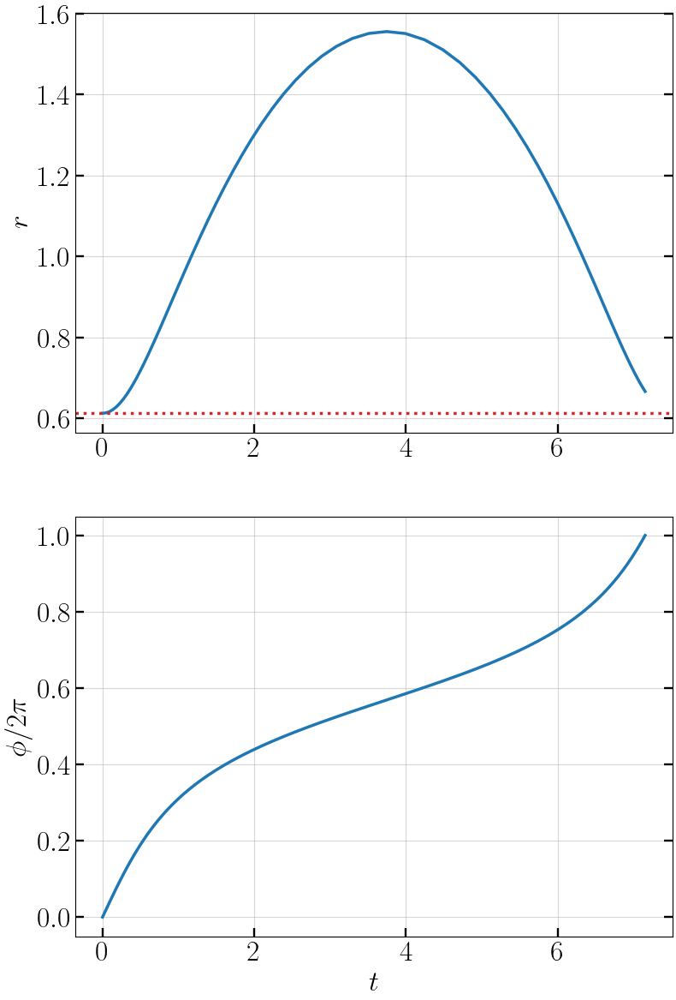

In [10]:
# does r finishes one cycle when phi evolves by 2pi?

def hit_phi_2pi(t, y, mu, k):
    phi = y[2]
    diff = phi - 2.*np.pi
    return diff

hit_phi_2pi.terminal = True
hit_phi_2pi.direction = 1

y_init = np.array([r_min, 0, 0, ll/(mu*r_min**2)])

t_span = (0, 30)
sol = integ.solve_ivp(orb_motion_r_pert, t_span, y_init, args=(mu, kk), 
                      atol=1e-8, rtol=1e-8, 
                      events=hit_phi_2pi)

tt = sol.t
rr = sol.y[0]
phi = sol.y[2]


# note that when phi changes by 2*pi
# r also evolves by exactly one cycle (e.g. from r_min to r_min exactly)
fig=plt.figure(figsize=(9, 14))
ax=fig.add_subplot(211)
ax.plot(tt, rr)
ax.axhline(r_min, ls=':', color='tab:red')

ax.set_ylabel(r'$r$')

ax=fig.add_subplot(212)
ax.plot(tt, phi/2/np.pi)

ax.set_xlabel(r'$t$')
ax.set_ylabel(r'$\phi/2\pi$')

# now when phi evolves by 2 pi
# r doesn't return to its initial value!

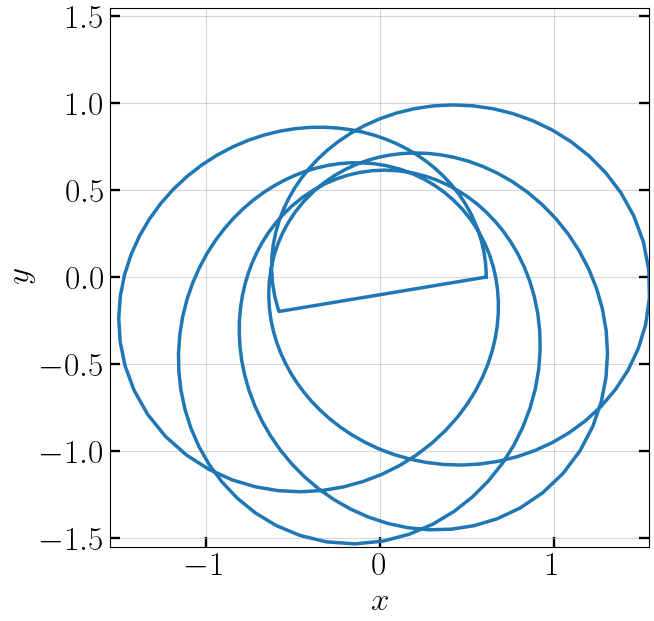

In [11]:
# let us visualize the orbit!

# starting the integration at the pericenter
y_init = np.array([r_min, 0, 0, ll/(mu*r_min**2)])

t_span = (0, 30)
sol = integ.solve_ivp(orb_motion_r_pert, t_span, y_init, args=(mu, kk), 
                      atol=1e-8, rtol=1e-8)

tt = sol.t
rr = sol.y[0]
phi = sol.y[2]


xx = rr*np.cos(phi)
yy = rr*np.sin(phi)

fig=plt.figure()
ax=fig.add_subplot(111)


line,  = ax.plot(xx[0], yy[0])

ax.set_xlim([-1.55, 1.55])
ax.set_ylim([-1.55, 1.55])
ax.set_aspect('equal')

x_plot = [xx[0]]
y_plot = [yy[0]]
 
def animation_function(i):
    i = int(i)
    x_plot.append(xx[i])
    y_plot.append(yy[i])
 
    line.set_xdata(x_plot)
    line.set_ydata(y_plot)
    return line,

animation = FuncAnimation(fig,
                          func = animation_function,
                          frames = len(xx),
                          interval = 10,
                          )

ax.set_xlabel(r'$x$')
ax.set_ylabel(r'$y$')

HTML(animation.to_jshtml())

# when the radial potential is no more 1/r, there will be orbit precession!
# E.g. the perihilion precession of Mercury! 


# part III: effect of a tangential perturbation (e.g., gravitational wave radiation)

In [12]:
def orb_motion_phi_pert(t, y, mu, k):
    r, drdt, phi, dphidt = y
    
    # gravitational wave radiation will induce a tangential acceleration of this form
    ddphi_pert = -2e-3 * dphidt / r**4
    
    dydt = np.zeros(len(y))
    
    # the first two eqs. describe the radial motion
    dydt[0] = drdt
    dydt[1] = r * dphidt**2 - k / (mu * r**2) 
    
    # the last two eqs. are for the tangential motion
    dydt[2] = dphidt
    dydt[3] = - 2. * drdt * dphidt / r  + ddphi_pert 
    return dydt

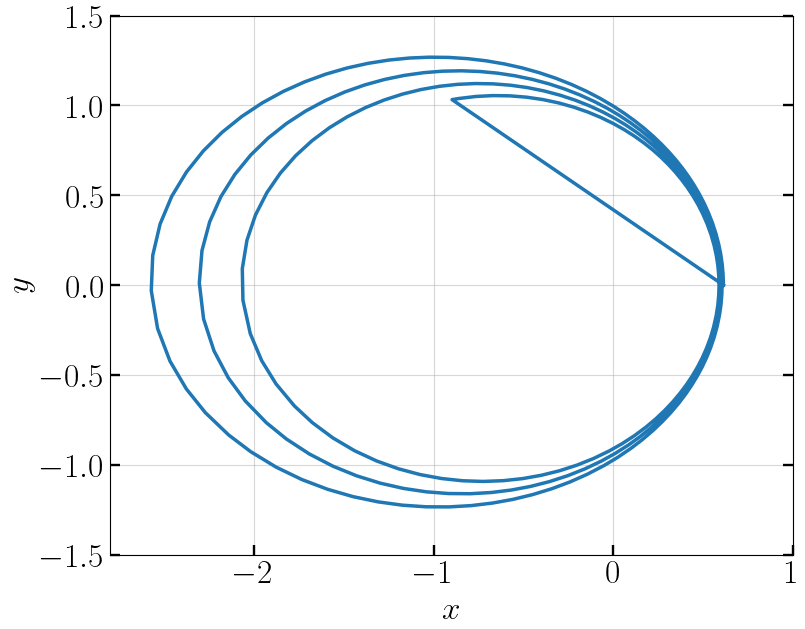

In [13]:
# let us visualize the orbit!

# starting the integration at the pericenter
y_init = np.array([r_min, 0, 0, ll/(mu*r_min**2)])

t_span = (0, 35)
sol = integ.solve_ivp(orb_motion_phi_pert, t_span, y_init, args=(mu, kk), 
                      atol=1e-8, rtol=1e-8)

tt = sol.t
rr = sol.y[0]
phi = sol.y[2]


xx = rr*np.cos(phi)
yy = rr*np.sin(phi)

fig=plt.figure()
ax=fig.add_subplot(111)

# ax.plot(xx, yy)


line,  = ax.plot(xx[0], yy[0])

ax.set_xlim([-2.8, 1.])
ax.set_ylim([-1.5, 1.5])
ax.set_aspect('equal')

x_plot = [xx[0]]
y_plot = [yy[0]]
 
def animation_function(i):
    i = int(i)
    x_plot.append(xx[i])
    y_plot.append(yy[i])
 
    line.set_xdata(x_plot)
    line.set_ydata(y_plot)
    return line,

animation = FuncAnimation(fig,
                          func = animation_function,
                          frames = len(xx),
                          interval = 10,
                          )

ax.set_xlabel(r'$x$')
ax.set_ylabel(r'$y$')

HTML(animation.to_jshtml())

# when there is a tangetial force, the orbit decays (a decreases) and circularizes (e decreases)
